In [1]:
import pandas as pd
import os
import altair as alt
alt.renderers.enable('mimetype')
alt.data_transformers.disable_max_rows()

import nltk
from nltk.tokenize import word_tokenize
## If you haven't downloaded the NLTK data sets yet, do so:
def download_nltk_data_if_needed(packages):
    for package in packages:
        try:
            nltk.data.find(package)
        except LookupError:
            nltk.download(package)

download_nltk_data_if_needed(['tokenizers/punkt', 'corpora/stopwords'])
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [2]:
processed_df = pd.read_csv("https://github.com/ZoeLeBlanc/dhq_scraper/raw/main/data/processed_dhq_data.csv")

In [3]:
processed_df['date_processed'] = pd.to_datetime(processed_df['date_processed'])

In [4]:
processed_df['github_counts'] = processed_df.body_text.str.count('github|GitHub|GITHUB|Github')
processed_df['word_count'] = processed_df.body_text.apply(lambda x: len(word_tokenize(x)))
processed_df['github_ratio'] = processed_df['github_counts'] / processed_df['word_count'] * 100

In [5]:
# count of articles with github
processed_df[processed_df.github_counts > 0][['DHQarticle-id']].nunique() / processed_df[['DHQarticle-id']].nunique() * 100

DHQarticle-id    17.403315
dtype: float64

In [6]:
alt.Chart(processed_df).mark_bar().encode(
    x='date_processed',
    y='sum(github_counts)',
)

<VegaLite 5 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/display_frontends.html#troubleshooting


In [7]:
import re
# New function to extract words or URLs containing 'github'
def extract_github_context(text):
    # This pattern looks for any word or URL that contains 'github'
    pattern = re.compile(r'\b\w*github\w*|\bhttp[s]?://\S*github\S*', re.IGNORECASE)
    return pattern.findall(text)

# Apply the function to each row
processed_df['github_context'] = processed_df.body_text.apply(extract_github_context)



In [8]:
processed_df[processed_df.github_counts > 0][['DHQarticle-id', 'github_context']]

,DHQarticle-id,github_context
170,172,"[Github, Github]"
171,174,"[GitHub, Github, https://github.com/),, GitHub]"
197,203,[https://github.com/dnikulin/factotum/.]
217,222,"[Github, https://github.com/dmberry/Digital-Hu..."
218,223,[GitHub]
...,...,...
700,683,[https://github.com/MatthewIreland/xml_lemmati...
703,701,"[https://github.com/TEIC/TEI/issues/1934), htt..."
704,703,"[https://inception-project.github.io,]"
712,726,"[https://github.com/kgeographer/linked-paths, ..."


In [9]:
exploded_github = processed_df[processed_df.github_counts > 0].explode('github_context')
text = ' '.join(exploded_github.github_context)

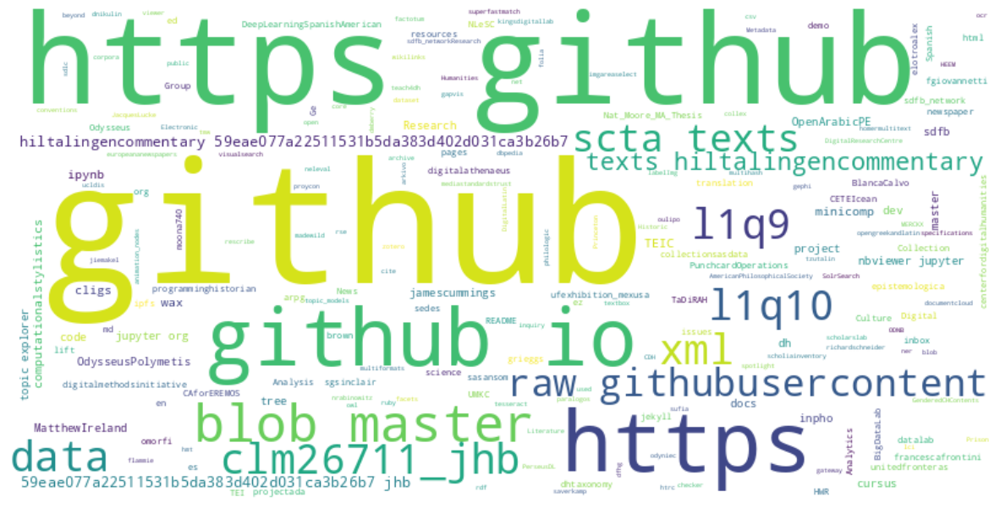

In [10]:
wordcloud = WordCloud(width=800, height=400, background_color ='white').generate(text)

# Display the word cloud using matplotlib
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off the axis
plt.show()